## Environments
Estos entornos permiten 3 intentos (vidas) para superar las 32 etapas en el juego. Los entornos solo envían fotogramas de juego recompensables a agentes; No se envían escenas de corte, pantallas de carga, etc. desde el emulador de NES a un agente ni puede un agente realizar acciones durante estas instancias. Si un La escena no se puede saltar pirateando la RAM de la NES, el entorno bloqueará el proceso de Python hasta que el emulador esté listo para la siguiente acción.

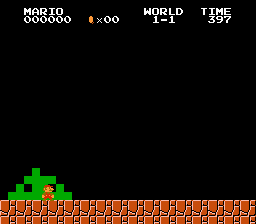


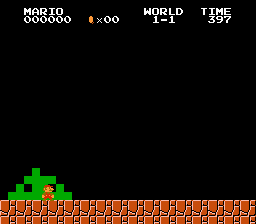

In [1]:
!pip install gym gym_super_mario_bros pyvirtualdisplay torch torchvision opencv-python imageio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.7/77.7 kB 2.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.1/199.1 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 87.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 44.3 MB/s eta 0:00:00
  Created wheel for nes-py: filename=nes_py-8.2.1-cp311-cp311-linux_x86_64.whl size=535718 sha256=fa00f864437cefd5db45b8b42d5cf37402b12065290e9fc009dc75ddd8757a29


In [2]:
# !pip install gym-super-mario-bros==7.4.0
# !pip !install torch torchvision matplotlib ipython


borra

In [3]:
import gym
import gym_super_mario_bros
from nes_py.wrappers import JoypadSpace
from gym_super_mario_bros.actions import SIMPLE_MOVEMENT
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import random
from collections import deque
import matplotlib.pyplot as plt
import cv2
import time

In [4]:
# Crear el entorno de Super Mario Bros con movimiento simple
env = gym_super_mario_bros.make("SuperMarioBros-v1")
env = JoypadSpace(env, SIMPLE_MOVEMENT)


/usr/local/lib/python3.11/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3`.
  logger.warn(
/usr/local/lib/python3.11/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.11/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(


In [5]:
class DQN(nn.Module):
    def __init__(self, n_actions):
        super(DQN, self).__init__()
        # Conv1: Imagen de entrada 84x84x4
        self.conv1 = nn.Conv2d(4, 32, kernel_size=8, stride=4)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2)
        self.conv3 = nn.Conv2d(64, 64, kernel_size=3, stride=1)

        # Capa fully connected
        self.fc1 = nn.Linear(7 * 7 * 64, 512)
        self.fc2 = nn.Linear(512, n_actions)

    def forward(self, x):
        # Propagación hacia adelante
        x = torch.relu(self.conv1(x))
        x = torch.relu(self.conv2(x))
        x = torch.relu(self.conv3(x))
        x = x.view(x.size(0), -1)  # Flatten
        x = torch.relu(self.fc1(x))
        return self.fc2(x)


In [6]:
class ReplayBuffer:
    def __init__(self, capacity):
        self.buffer = deque(maxlen=capacity)

    def push(self, state, action, reward, next_state, done):
        self.buffer.append((state, action, reward, next_state, done))

    def sample(self, batch_size):
        return random.sample(self.buffer, batch_size)

    def size(self):
        return len(self.buffer)


In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")

def preprocess_frame(frame):
    gray = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
    resized = cv2.resize(gray, (84, 84), interpolation=cv2.INTER_AREA)
    normalized = resized / 255.0
    return normalized.astype(np.float32)

def train_dqn(agent, buffer, batch_size, gamma, optimizer):
    if buffer.size() < batch_size:
        return

    batch = buffer.sample(batch_size)
    state, action, reward, next_state, done = zip(*batch)

    state = torch.FloatTensor(np.array(state)).to(device)
    next_state = torch.FloatTensor(np.array(next_state)).to(device)
    reward = torch.FloatTensor(np.array(reward)).to(device)
    done = torch.FloatTensor(np.array(done)).to(device)

    current_q_values = agent(state).gather(1, torch.LongTensor(action).view(-1, 1).to(device))
    next_q_values = agent(next_state).max(1)[0].detach()
    target_q_values = reward + gamma * next_q_values * (1 - done)

    loss = nn.MSELoss()(current_q_values.view(-1), target_q_values)

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    return loss.item()


Usando dispositivo: cuda


In [8]:
# def train_dqn(agent, buffer, batch_size, gamma, optimizer):
#     if buffer.size() < batch_size:
#         return  # No entrenamos hasta que haya suficiente experiencia

#     # Muestrear un batch de experiencias del buffer
#     batch = buffer.sample(batch_size)
#     state, action, reward, next_state, done = zip(*batch)

#     state = torch.FloatTensor(np.array(state))
#     next_state = torch.FloatTensor(np.array(next_state))
#     reward = torch.FloatTensor(np.array(reward))
#     done = torch.FloatTensor(np.array(done))

#     # Q-values actuales
#     current_q_values = agent(state).gather(1, torch.LongTensor(action).view(-1, 1))

#     # Q-values objetivo usando la siguiente mejor acción
#     next_q_values = agent(next_state).max(1)[0].detach()
#     target_q_values = reward + (gamma * next_q_values * (1 - done))

#     # Calcular la pérdida
#     loss = nn.MSELoss()(current_q_values.view(-1), target_q_values)

#     # Optimizar
#     optimizer.zero_grad()
#     loss.backward()
#     optimizer.step()

#     return loss.item()
    

In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando dispositivo: {device}")


Usando dispositivo: cuda


In [10]:
import torch
print(f"Usando dispositivo: {torch.device('cuda' if torch.cuda.is_available() else 'cpu')}")


Usando dispositivo: cuda


In [11]:
import torch
print(torch.cuda.is_available())  # Debería devolver: True
print(torch.cuda.get_device_name(0))  # Debería mostrar el nombre de la GPU (Tesla T4, etc.)


True
Tesla T4


In [12]:
n_actions = env.action_space.n
agent = DQN(n_actions).to(device)
optimizer = optim.Adam(agent.parameters(), lr=1e-4)
buffer = ReplayBuffer(10000)

# Parámetros
num_episodes = 150
batch_size = 32
gamma = 0.99
epsilon = 1.0
epsilon_min = 0.1
epsilon_decay = 0.995


In [13]:
def preprocess_frame(frame):
    # Si ya está en escala de grises, no convertir
    if len(frame.shape) == 3 and frame.shape[2] == 3:
        gray = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
    else:
        gray = frame  # Ya es gris

    resized = cv2.resize(gray, (84, 84), interpolation=cv2.INTER_AREA)
    normalized = resized / 255.0
    return normalized.astype(np.float32)


In [14]:
# def preprocess_frame(frame):
#     gray = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
#     resized = cv2.resize(gray, (84, 84), interpolation=cv2.INTER_AREA)
#     normalized = resized / 255.0
#     return normalized


In [15]:
all_rewards = []

for episode in range(num_episodes):
    state = preprocess_frame(env.reset()[0])
    state_stack = np.stack([state] * 4, axis=0)  # (4, 84, 84)
    episode_reward = 0

    done = False
    while not done:
        # Epsilon-greedy
        if random.random() < epsilon:
            action = env.action_space.sample()
        else:
            with torch.no_grad():
                state_tensor = torch.FloatTensor(state_stack).unsqueeze(0).to(device)
                q_values = agent(state_tensor)
                action = q_values.argmax().item()

        next_state_raw, reward, done, info = env.step(action)
        next_state = preprocess_frame(next_state_raw)
        next_state_stack = np.append(state_stack[1:], [next_state], axis=0)

        buffer.push(state_stack, action, reward, next_state_stack, done)
        loss = train_dqn(agent, buffer, batch_size, gamma, optimizer)

        state_stack = next_state_stack
        episode_reward += reward

    epsilon = max(epsilon_min, epsilon * epsilon_decay)
    all_rewards.append(episode_reward)

    print(f"Ep {episode+1}: Reward = {episode_reward}, Epsilon = {epsilon:.3f}")


/usr/local/lib/python3.11/dist-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/usr/local/lib/python3.11/dist-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):


Ep 1: Reward = 530.0, Epsilon = 0.995
Ep 2: Reward = 711.0, Epsilon = 0.990
Ep 3: Reward = 446.0, Epsilon = 0.985
Ep 4: Reward = 427.0, Epsilon = 0.980
Ep 5: Reward = 441.0, Epsilon = 0.975
Ep 6: Reward = 500.0, Epsilon = 0.970
Ep 7: Reward = 514.0, Epsilon = 0.966
Ep 8: Reward = 629.0, Epsilon = 0.961
Ep 9: Reward = 400.0, Epsilon = 0.956
Ep 10: Reward = 477.0, Epsilon = 0.951
Ep 11: Reward = 587.0, Epsilon = 0.946
Ep 12: Reward = 602.0, Epsilon = 0.942
Ep 13: Reward = 1095.0, Epsilon = 0.937
Ep 14: Reward = 634.0, Epsilon = 0.932
Ep 15: Reward = 488.0, Epsilon = 0.928
Ep 16: Reward = 815.0, Epsilon = 0.923
Ep 17: Reward = 651.0, Epsilon = 0.918
Ep 18: Reward = 491.0, Epsilon = 0.914
Ep 19: Reward = 482.0, Epsilon = 0.909
Ep 20: Reward = 656.0, Epsilon = 0.905
Ep 21: Reward = 400.0, Epsilon = 0.900
Ep 22: Reward = 729.0, Epsilon = 0.896
Ep 23: Reward = 488.0, Epsilon = 0.891
Ep 24: Reward = 402.0, Epsilon = 0.887
Ep 25: Reward = 1078.0, Epsilon = 0.882
Ep 26: Reward = 620.0, Epsilon =

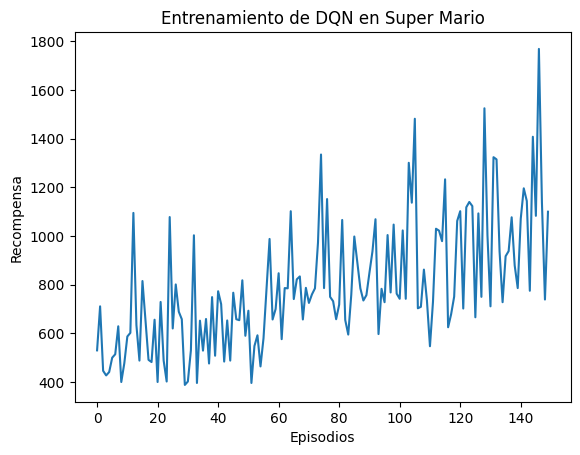

In [16]:
plt.plot(all_rewards)
plt.xlabel('Episodios')
plt.ylabel('Recompensa')
plt.title('Entrenamiento de DQN en Super Mario')
plt.show()


In [17]:
torch.save(agent.state_dict(), "mario_dqn.pth")


In [18]:
next(agent.parameters()).device


device(type='cuda', index=0)

In [19]:
from matplotlib import animation
from IPython.display import HTML
import matplotlib.pyplot as plt

# Función que actualiza la animación
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch,

# Función para crear la animación
def plot_animation(frames, repeat=False, interval=33):  # 30 FPS ≈ 33 ms por frame
    fig = plt.figure(figsize=(6, 6))
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

# Ejecutar un episodio usando el agente entrenado y recolectar los frames
def evaluar_agente(agent, env, device):
    state = preprocess_frame(env.reset()[0])
    state_stack = np.stack([state] * 4, axis=0)
    frames = []
    done = False
    total_reward = 0

    while not done:
        # Capturar el frame actual para visualización
        frame_rgb = env.render(mode='rgb_array')
        frames.append(frame_rgb)

        # Selección de acción usando el agente entrenado
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state_stack).unsqueeze(0).to(device)
            action = agent(state_tensor).argmax().item()

        next_state_raw, reward, done, info = env.step(action)
        next_state = preprocess_frame(next_state_raw)
        state_stack = np.append(state_stack[1:], [next_state], axis=0)
        total_reward += reward

        print(f"Total frames recolectados: {len(frames)}")


    return frames, total_reward

In [20]:
# Asegúrate de que el entorno fue creado con render_mode='rgb_array'
env = gym_super_mario_bros.make("SuperMarioBros-v1")
env = JoypadSpace(env, SIMPLE_MOVEMENT)

# Ejecutar episodio y recolectar frames
frames, total_reward = evaluar_agente(agent, env, device)

# Crear animación interactiva
anim = plot_animation(frames)

# Mostrarla en la celda
print(f"Recompensa total del agente en este episodio: {total_reward}")
HTML(anim.to_jshtml())

/usr/local/lib/python3.11/dist-packages/gym/envs/registration.py:593: UserWarning: WARN: The environment SuperMarioBros-v1 is out of date. You should consider upgrading to version `v3`.
  logger.warn(
/usr/local/lib/python3.11/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.11/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.11/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See he

Total frames recolectados: 1
Total frames recolectados: 2
Total frames recolectados: 3
Total frames recolectados: 4
Total frames recolectados: 5
Total frames recolectados: 6
Total frames recolectados: 7
Total frames recolectados: 8
Total frames recolectados: 9
Total frames recolectados: 10
Total frames recolectados: 11
Total frames recolectados: 12
Total frames recolectados: 13
Total frames recolectados: 14
Total frames recolectados: 15
Total frames recolectados: 16
Total frames recolectados: 17
Total frames recolectados: 18
Total frames recolectados: 19
Total frames recolectados: 20
Total frames recolectados: 21
Total frames recolectados: 22
Total frames recolectados: 23
Total frames recolectados: 24
Total frames recolectados: 25
Total frames recolectados: 26
Total frames recolectados: 27
Total frames recolectados: 28
Total frames recolectados: 29
Total frames recolectados: 30
Total frames recolectados: 31
Total frames recolectados: 32
Total frames recolectados: 33
Total frames recole